In [1]:
import os
import csv
import pandas as pd

import librosa
import librosa.display

import matplotlib.pyplot as plt
import numpy as np

## UrbanSound8k Dataset에 대한 FOLD별 이름 설정

In [2]:
root = 'D:\GH\Audio\dataset\\UrbanSound8K\\audio'
root_total = 'D:\GH\Audio\dataset\\UrbanSound8K\\audio\\Total'
csv_root = 'D:\GH\Audio\dataset\\UrbanSound8K\metadata\\UrbanSound8K.csv'

In [3]:
def Mel_spectrogram(y, sr, log=False):
    ## Mel-Spectogram
    S = librosa.feature.melspectrogram(y=y, sr=sr)
    if log:
        log_S = librosa.power_to_db(S, ref=np.max)
        return log_S
    return S

In [4]:
### LABEL list 생성
csv_Data = pd.read_csv(csv_root)

### zero-padding for 4seconds
target_length = 88200

In [6]:
dataset = np.array([])
for idx, file in enumerate(os.listdir(root_total)):
    # print("# path : " + root + '\\' + file)
    filepath = os.path.join(root_total, file)
    y, sr = librosa.load(filepath)

    # zero-padding until 4 seconds
    if y.shape[0] < target_length:
        target_y = np.pad(y, (0, target_length - y.shape[0] - 1), 'constant', constant_values=0)
    elif y.shape[0] > target_length:
        target_y = y[:target_length]
    else:
        target_y = y

    log_S = Mel_spectrogram(target_y, sr, log=True)

    temp_data = csv_Data[csv_Data['slice_file_name'] == file]
    label = temp_data['classID'].values[0]

    if idx == 0:
        dataset = [file, label, log_S]
    else:
        dataset = np.vstack((dataset, [file, label, log_S]))

    print("{}, filename: {}, Done".format(idx, file))

print(dataset.shape)
np.save(root_total + '.npy', dataset)

0, filename: 100032-3-0-0.wav, Done
1, filename: 100263-2-0-117.wav, Done


c:\Users\angel\anaconda3\envs\tf_dl\lib\site-packages\numpy\core\shape_base.py:121: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)


2, filename: 100263-2-0-121.wav, Done
3, filename: 100263-2-0-126.wav, Done
4, filename: 100263-2-0-137.wav, Done
5, filename: 100263-2-0-143.wav, Done
6, filename: 100263-2-0-161.wav, Done
7, filename: 100263-2-0-3.wav, Done
8, filename: 100263-2-0-36.wav, Done
9, filename: 100648-1-0-0.wav, Done
10, filename: 100648-1-1-0.wav, Done
11, filename: 100648-1-2-0.wav, Done
12, filename: 100648-1-3-0.wav, Done
13, filename: 100648-1-4-0.wav, Done
14, filename: 100652-3-0-0.wav, Done
15, filename: 100652-3-0-1.wav, Done
16, filename: 100652-3-0-2.wav, Done
17, filename: 100652-3-0-3.wav, Done
18, filename: 100795-3-0-0.wav, Done
19, filename: 100795-3-1-0.wav, Done
20, filename: 100795-3-1-1.wav, Done
21, filename: 100795-3-1-2.wav, Done
22, filename: 100852-0-0-0.wav, Done
23, filename: 100852-0-0-1.wav, Done
24, filename: 100852-0-0-10.wav, Done
25, filename: 100852-0-0-11.wav, Done
26, filename: 100852-0-0-12.wav, Done
27, filename: 100852-0-0-13.wav, Done
28, filename: 100852-0-0-14.wav

## UrbanSound8k Dataset에 대한 FOLD별 파일이름 및 라벨 설정

In [11]:
fold_label = np.array([])
for (root, dirs, files) in os.walk(root):
    idx = 0
    print("# root : " + root)

    if root[-1] == str(1):
        csv_fold = csv_Data[csv_Data['fold'] == 1]
    elif root[-1] == str(2):
        csv_fold = csv_Data[csv_Data['fold'] == 2]
    elif root[-1] == str(3):
        csv_fold = csv_Data[csv_Data['fold'] == 3]
    elif root[-1] == str(4):
        csv_fold = csv_Data[csv_Data['fold'] == 4]
    elif root[-1] == str(5):
        csv_fold = csv_Data[csv_Data['fold'] == 5]
    elif root[-1] == str(6):
        csv_fold = csv_Data[csv_Data['fold'] == 6]
    elif root[-1] == str(7):
        csv_fold = csv_Data[csv_Data['fold'] == 7]
    elif root[-1] == str(8):
        csv_fold = csv_Data[csv_Data['fold'] == 8]
    elif root[-1] == str(9):
        csv_fold = csv_Data[csv_Data['fold'] == 9]
    elif root[-1] == str(0):
        csv_fold = csv_Data[csv_Data['fold'] == 10]
    else:
        continue

    if len(dirs) > 0:
        for dir_name in dirs:
            print("dir: " + dir_name)

    if len(files) > 0:
        for file_name in files:
            temp_title = file_name
            print("file: " + file_name)
            temp_data = csv_fold[csv_fold['slice_file_name'] == file_name]
            # print(temp_data)
            if temp_data.shape[0] == 0:
                continue
            label = temp_data['classID'].values[0]
            # print(label)

            if idx == 0:
                fold_label = [file_name, label]
            else:
                fold_label = np.vstack((fold_label, [file_name, label]))
            idx += 1

        print(fold_label.shape)
        print(root)
        np.save(root+'.npy', fold_label)

# root : D:\GH\Audio\dataset\UrbanSound8K\audio
# root : D:\GH\Audio\dataset\UrbanSound8K\audio\fold1
file: .DS_Store
file: 101415-3-0-2.wav
file: 101415-3-0-3.wav
file: 101415-3-0-8.wav
file: 102106-3-0-0.wav
file: 102305-6-0-0.wav
file: 102842-3-0-1.wav
file: 102842-3-1-0.wav
file: 102842-3-1-5.wav
file: 102842-3-1-6.wav
file: 103074-7-0-0.wav
file: 103074-7-0-1.wav
file: 103074-7-0-2.wav
file: 103074-7-1-0.wav
file: 103074-7-1-1.wav
file: 103074-7-1-2.wav
file: 103074-7-1-3.wav
file: 103074-7-1-4.wav
file: 103074-7-1-5.wav
file: 103074-7-1-6.wav
file: 103074-7-2-0.wav
file: 103074-7-3-0.wav
file: 103074-7-3-1.wav
file: 103074-7-3-2.wav
file: 103074-7-3-3.wav
file: 103074-7-4-0.wav
file: 103074-7-4-1.wav
file: 103074-7-4-2.wav
file: 103074-7-4-3.wav
file: 103074-7-4-4.wav
file: 103074-7-4-5.wav
file: 103074-7-4-6.wav
file: 103258-5-0-0.wav
file: 103258-5-0-1.wav
file: 103258-5-0-10.wav
file: 103258-5-0-11.wav
file: 103258-5-0-12.wav
file: 103258-5-0-13.wav
file: 103258-5-0-14.wav
fil

## UrbanSound8k Total Dataset에 대한 FOLD별 학습용 데이터셋, 테스트용 데이터셋 구분

In [15]:
loaded = np.load(root_total+'.npy', allow_pickle=True)
pd_loaded = pd.DataFrame(loaded, columns=['filename', 'label', 'data'])

train_dataset = pd.DataFrame(columns = ['filename', 'label', 'data'])
test_dataset = pd.DataFrame(columns = ['filename', 'label', 'data'])

for i in range(1,11):
    name = 'fold' + str(i) + '.npy'
    fold_load = np.load('D:\GH\Audio\dataset\\UrbanSound8K\\audio\\' + name, allow_pickle=True)

    for idx, file in enumerate(loaded):
        if idx < fold_load.shape[0]:
            temp_data = pd_loaded[pd_loaded['filename'] == fold_load[idx][0]]
            if temp_data.isnull == False:
                train_dataset = train_dataset.append(temp_data)
            else:
                test_dataset = test_dataset.append(temp_data)
        else:
            temp_data = pd_loaded[pd_loaded['filename'] == file[0]]
            train_dataset = train_dataset.append(temp_data)

        # print(train_dataset)
        # print(test_dataset)
    np_train = train_dataset.to_numpy()
    np_test = test_dataset.to_numpy()

    train_dataset = pd.DataFrame(columns=['filename', 'label', 'data'])
    test_dataset = pd.DataFrame(columns=['filename', 'label', 'data'])

    print(name[:-4] + ' done')
    print(np_train.shape)
    print(np_test.shape)
    np.save('D:\GH\Audio\dataset\\UrbanSound8K\\audio\\np_data\\' + name[:-4] + 'train.npy', np_train)
    np.save('D:\GH\Audio\dataset\\UrbanSound8K\\audio\\np_data\\' + name[:-4] + 'test.npy', np_test)

C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold1 done
(7859, 3)
(873, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold2 done
(7844, 3)
(888, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold3 done
(7807, 3)
(925, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold4 done
(7742, 3)
(990, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold5 done
(7796, 3)
(936, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold6 done
(7909, 3)
(823, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold7 done
(7894, 3)
(838, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold8 done
(7926, 3)
(806, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold9 done
(7916, 3)
(816, 3)


C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\Users\angel\AppData\Local\Temp\ipykernel_10568\1908182251.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  test_dataset = test_dataset.append(temp_data)
C:\U

fold10 done
(7895, 3)
(837, 3)


## UrbanSound8k FOLD1기준 딥러닝 모델 학습을 위한 데이터셋 구성

# Need
- Total.npy
- fold1train.npy
- fold1test.npy

In [5]:
load_path = 'D:\GH\Audio\dataset\\UrbanSound8K\\audio\\np_data'

'''
loaded = np.load('파일명.npz', allow_pickle=True)
'''

train_path = os.path.join(load_path, 'fold1train.npy')
test_path = os.path.join(load_path, 'fold1test.npy')

train_data = np.load(train_path, allow_pickle=True)
test_data = np.load(test_path, allow_pickle=True)
print(train_data.shape)
print(test_data.shape)

x_train = train_data[:, -1]
y_train = train_data[:, 1]
x_test = test_data[:, -1]
y_test = test_data[:, 1]
print('\n Divide Data')
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

x_train = np.stack(x_train, axis=0)
x_test = np.stack(x_test, axis=0)
print('\n Np Stack')
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

x_train = x_train[...,np.newaxis]
x_test = x_test[...,np.newaxis]
y_train = y_train.reshape((-1,))
y_test = y_test.reshape((-1,))

print('\n Add axis')
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

# 배열의 원소 개수만큼 인덱스 배열을 만든 후
# 무작위로 뒤섞어 줍니다.
idx_train = np.arange(x_train.shape[0])
idx_test = np.arange(x_test.shape[0])
# print(idx)
np.random.shuffle(idx_train)
np.random.shuffle(idx_test)

x_train_shuffle = x_train[idx_train]
y_train_shuffle = y_train[idx_train]
x_test_shuffle = x_test[idx_test]
y_test_shuffle = y_test[idx_test]

print('\n Shuffle Data')
print(x_train_shuffle.shape)
print(y_train_shuffle.shape)
print(x_test_shuffle.shape)
print(y_test_shuffle.shape)

print('\n Data Type')
print(type(x_train_shuffle))
print(type(y_train_shuffle))
print(type(x_test_shuffle))
print(type(y_test_shuffle))

(7859, 3)
(873, 3)

 Divide Data
(7859,)
(7859,)
(873,)
(873,)

 Np Stack
(7859, 128, 173)
(7859,)
(873, 128, 173)
(873,)

 Add axis
(7859, 128, 173, 1)
(7859,)
(873, 128, 173, 1)
(873,)

 Shuffle Data
(7859, 128, 173, 1)
(7859,)
(873, 128, 173, 1)
(873,)

 Data Type
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [6]:
# TensorFlow에서 읽을 수 있는 np.astype으로 변경
x_train = np.asarray(x_train_shuffle).astype(np.float64)
y_train = np.asarray(y_train_shuffle).astype(np.int64)
x_test = np.asarray(x_test_shuffle).astype(np.float64)
y_test = np.asarray(y_test_shuffle).astype(np.int64)

print('Train Dataset')
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

print(type(x_train_shuffle))
print(type(y_train_shuffle))
print(type(x_test_shuffle))
print(type(y_test_shuffle))

Train Dataset
(7859, 128, 173, 1)
(7859,)
(873, 128, 173, 1)
(873,)
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [7]:
print(x_train[0].shape)
print(y_train[0])

(128, 173, 1)
0


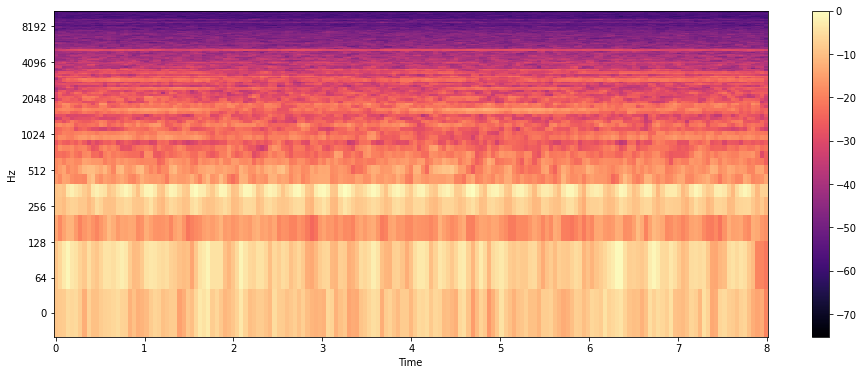

In [10]:
plt.figure(figsize=(16, 6))
librosa.display.specshow(x_train[0].reshape(128, 173), sr=22050, hop_length=1024, x_axis='time', y_axis='log')
plt.colorbar()
plt.show()